Calculate the Bayes Factor for SFR to determine whether the void and wall samples are drawn from the same or different parent distributions.

In [1]:
from astropy.table import Table
from astropy.io import fits

import numpy as np

import sys

import pickle

import pocomc as pc

import matplotlib
import matplotlib.pyplot as plt

from functions import Model_1_plot, Model_2_plot

np.set_printoptions(threshold=sys.maxsize)

In [2]:
matplotlib.rc('font', size=14)
matplotlib.rc('font', family='DejaVu Sans')

# Data

In [3]:
#data_directory = '../../../../data/'
data_directory = '../../../../Data/NSA/'
data_filename = data_directory + 'NSA_v1_0_1_VAGC_vflag-V2-VF.fits'

hdu = fits.open(data_filename)
data = Table(hdu[1].data)
hdu.close()

## Just keep the main SDSS DR7 footprint

In [4]:
# When the catalog is the NSA, only keep those objects which were originally in the DR7 LSS
catalog_SDSS = data[data['IN_DR7_LSS'] == 1]

ra_boolean = np.logical_and(catalog_SDSS['RA'] > 110, catalog_SDSS['RA'] < 270)
catalog_north = catalog_SDSS[ra_boolean]

strip_boolean = np.logical_and.reduce([catalog_north['RA'] > 250, 
                                       catalog_north['RA'] < 269, 
                                       catalog_north['DEC'] > 51, 
                                       catalog_north['DEC'] < 67])
catalog_main = catalog_north[~strip_boolean]

In [5]:
SFR = np.array(catalog_main['SFR'])

## Separate galaxies by their LSS classifications

### $V^2$

In [6]:
wall_v2 = catalog_main['vflag_V2'] == 0
void_v2 = catalog_main['vflag_V2'] == 1
edge_v2 = catalog_main['vflag_V2'] == 2
out_v2 = catalog_main['vflag_V2'] == 9

### VoidFinder

In [7]:
wall_vf = catalog_main['vflag_VF'] == 0
void_vf = catalog_main['vflag_VF'] == 1
edge_vf = catalog_main['vflag_VF'] == 2
out_vf = catalog_main['vflag_VF'] == 9

In [8]:
del catalog_main, catalog_north, data

# Fit the SFR distributions with skewnormal distributions

Both one- and two-parent models

This is a bimodal distribution

In [10]:
SFR_bins = np.arange(-2.5, 1.5, 0.1)

In [9]:
labels1_tri = ['s', 'a', r'$\mu_a$', r'$\sigma_a$', 'skew$_a$', 
                    'b', r'$\mu_b$', r'$\sigma_b$', 'skew$_b$', 
                    'c', r'$\mu_c$', r'$\sigma_c$', 'skew$_c$']
labels2_tri = ['$a_1$', r'$\mu_{1a}$', r'$\sigma_{1a}$', 'skew$_{1a}$', 
               '$b_1$', r'$\mu_{1b}$', r'$\sigma_{1b}$', 'skew$_{1b}$', 
               '$c_2$', r'$\mu_{1c}$', r'$\sigma_{1c}$', 'skew$_{1c}$', 
               '$a_2$', r'$\mu_{2a}$', r'$\sigma_{2a}$', 'skew$_{2a}$', 
               '$b_2$', r'$\mu_{2b}$', r'$\sigma_{2b}$', 'skew$_{2b}$', 
               '$c_2$', r'$\mu_{2c}$', r'$\sigma_{2c}$', 'skew$_{2c}$']

## V$^2$

### 1-parent model

In [11]:
temp_infile = open('pocoMC_results/sampler_results_M1_SFR_V2.pickle', 'rb')
V2_results1 = pickle.load(temp_infile)
temp_infile.close()

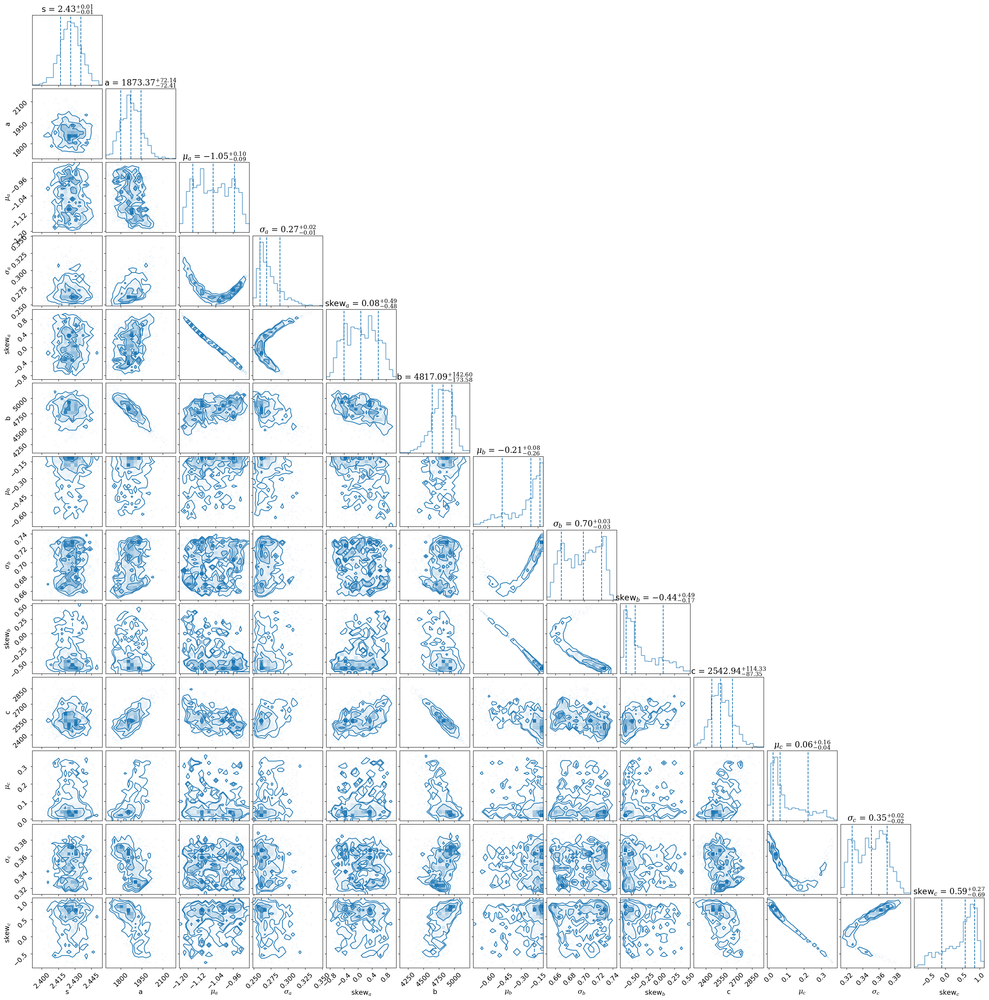

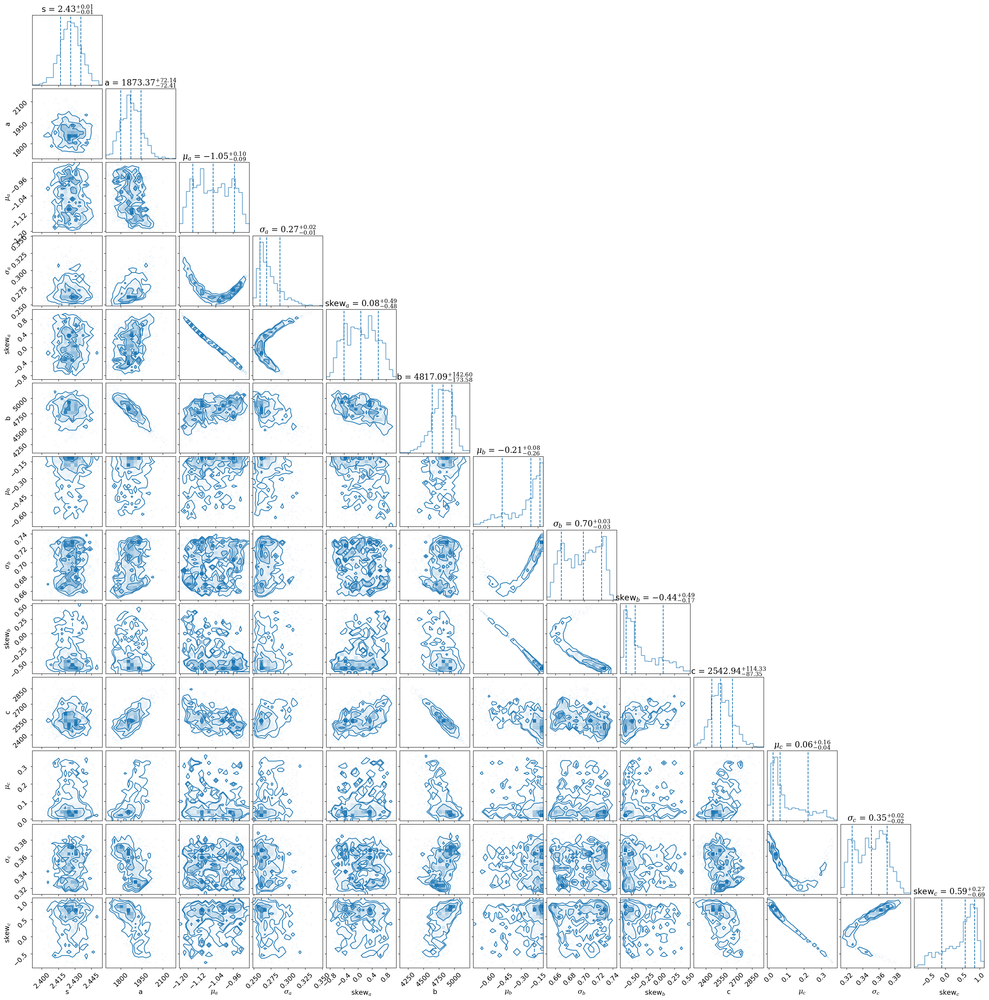

In [12]:
pc.plotting.corner(V2_results1, 
                   labels=labels1_tri, 
                   dims=range(len(labels1_tri)), 
                   show_titles=True, 
                   quantiles=[0.16, 0.5, 0.84])

In [13]:
lnzM1_V2 = V2_results1['logz'][-1]
lnzM1_V2

-674.6241962857559

In [14]:
V2_bestfit1 = np.mean(V2_results1['samples'], axis=0)

V2_bestfit1

array([ 2.4260666e+00,  1.8761027e+03, -1.0493374e+00,  2.7266422e-01,
        8.6068980e-02,  4.8020513e+03, -2.7391231e-01,  6.9678640e-01,
       -3.2134497e-01,  2.5539136e+03,  1.0570562e-01,  3.5002294e-01,
        4.3446013e-01], dtype=float32)

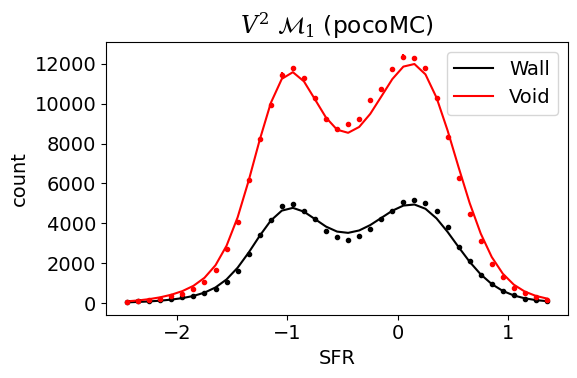

In [15]:
Model_1_plot(V2_bestfit1, 
             SFR[wall_v2], 
             SFR[void_v2], 
             SFR_bins, 
             3, 
             xlabel_text='SFR', 
             title_text=r'$V^2$ $\mathcal{M}_1$ (pocoMC)')

### 2-parent model

In [16]:
temp_infile = open('pocoMC_results/sampler_results_M2_SFR_V2.pickle', 'rb')
V2_results2 = pickle.load(temp_infile)
temp_infile.close()

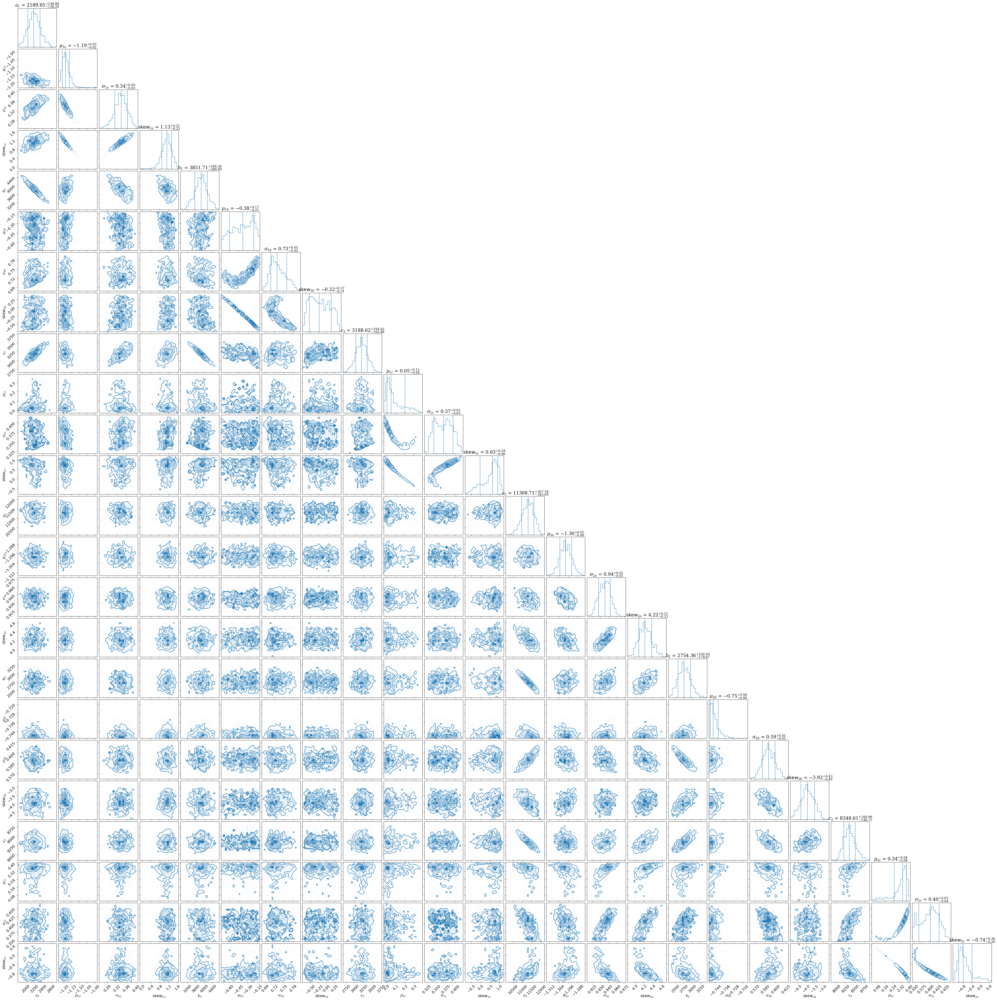

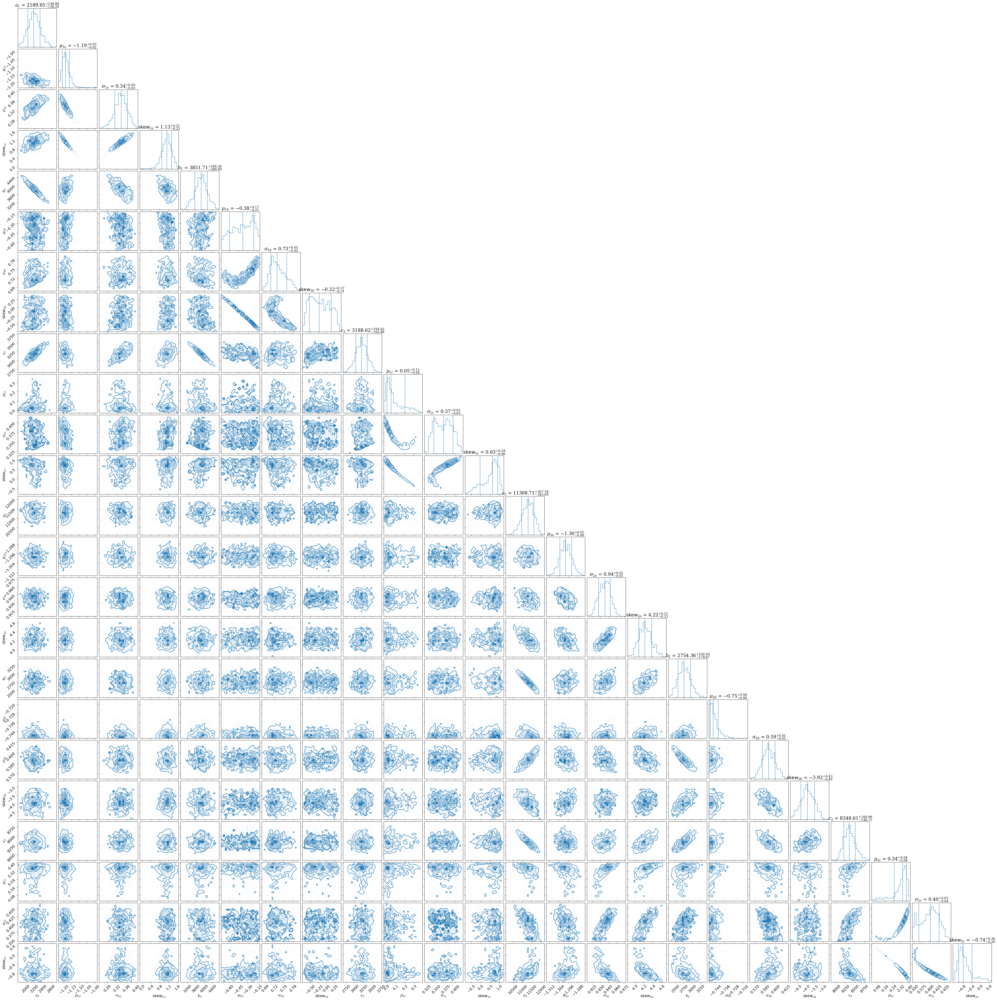

In [17]:
pc.plotting.corner(V2_results2, 
                   labels=labels2_tri, 
                   dims=range(len(labels2_tri)), 
                   show_titles=True, 
                   quantiles=[0.16, 0.5, 0.84])

In [18]:
lnzM2_V2 = V2_results2['logz'][-1]
lnzM2_V2

-502.4917100323037

In [19]:
V2_bestfit2 = np.mean(V2_results2['samples'], axis=0)

V2_bestfit2

array([ 2.1978242e+03, -1.1862755e+00,  3.3645260e-01,  1.1089138e+00,
        3.8494431e+03, -3.9307296e-01,  7.3168427e-01, -1.9986400e-01,
        3.1889712e+03,  8.6207218e-02,  3.6875895e-01,  4.9737659e-01,
        1.1287746e+04, -1.2982645e+00,  9.3822324e-01,  4.2311482e+00,
        2.7631738e+03, -7.4515235e-01,  5.9018862e-01, -3.9135435e+00,
        8.3556953e+03,  3.1141916e-01,  4.0062365e-01, -6.4499032e-01],
      dtype=float32)

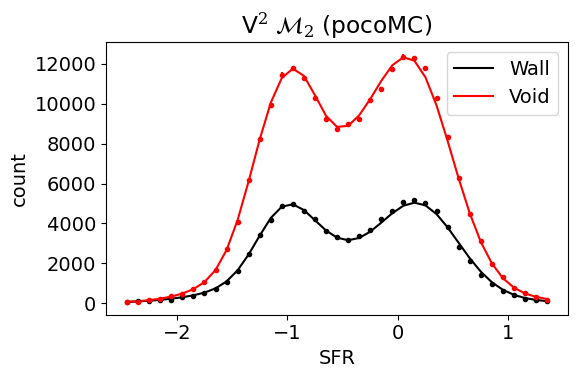

In [20]:
Model_2_plot(V2_bestfit2, 
             SFR[wall_v2], 
             SFR[void_v2], 
             SFR_bins, 
             3, 
             xlabel_text='SFR', 
             title_text=r'V$^2$ $\mathcal{M}_2$ (pocoMC)')

### Calculate Bayes factor

In [21]:
lnB12_V2 = lnzM1_V2 - lnzM2_V2

B12_V2 = np.exp(lnB12_V2)

print('V2 SFR: B12 = {:.3g}; log(B12) = {:.3f}'.format(B12_V2, lnB12_V2*np.log10(np.exp(1))))

V2 SFR: B12 = 1.75e-75; log(B12) = -74.756


## VoidFinder

### 1-parent model

In [22]:
temp_infile = open('pocoMC_results/sampler_results_M1_SFR_VoidFinder.pickle', 'rb')
VF_results1 = pickle.load(temp_infile)
temp_infile.close()

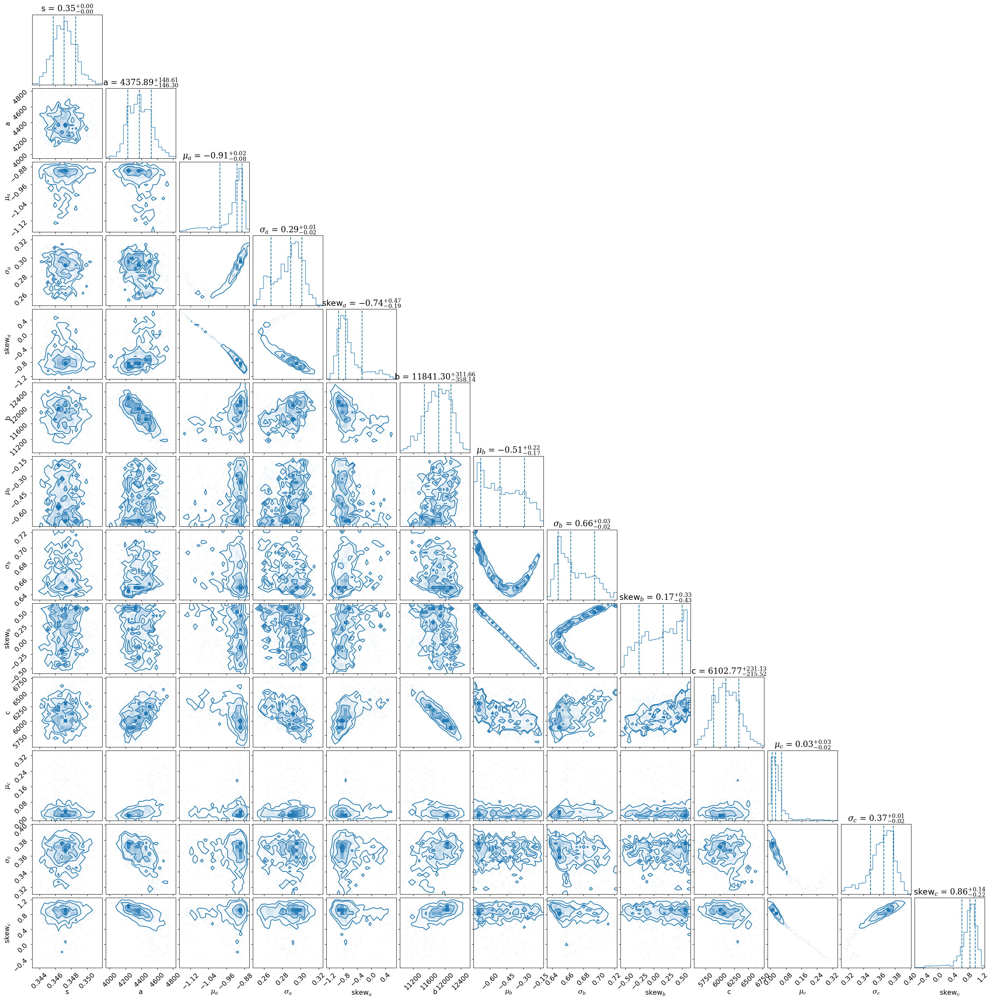

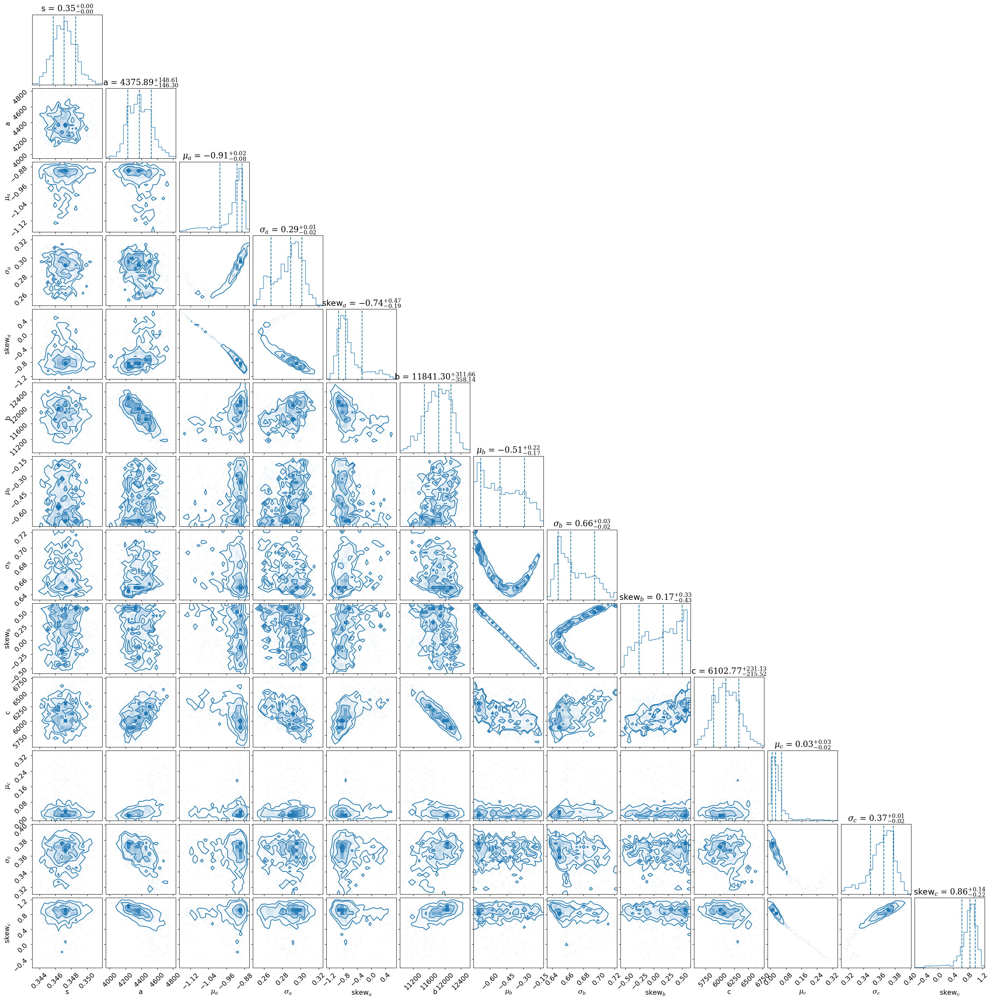

In [23]:
pc.plotting.corner(VF_results1, 
                   labels=labels1_tri, 
                   dims=range(len(labels1_tri)), 
                   show_titles=True, 
                   quantiles=[0.16, 0.5, 0.84])

In [24]:
lnzM1_VF = VF_results1['logz'][-1]
lnzM1_VF

-1497.9506198008462

In [25]:
VF_bestfit1 = np.mean(VF_results1['samples'], axis=0)

VF_bestfit1

array([ 3.4713694e-01,  4.3813501e+03, -9.3688345e-01,  2.8627178e-01,
       -6.1982518e-01,  1.1817957e+04, -4.9000141e-01,  6.6923511e-01,
        1.2830567e-01,  6.1142993e+03,  3.9194725e-02,  3.6301839e-01,
        8.0079198e-01], dtype=float32)

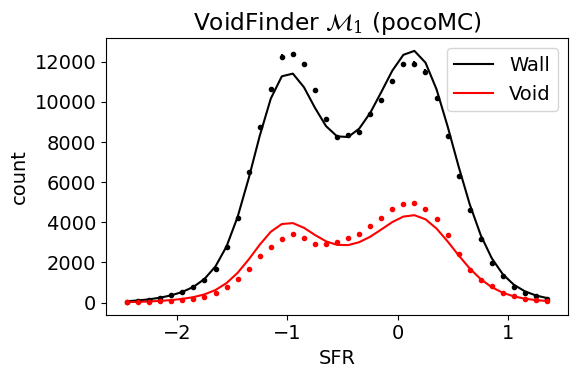

In [26]:
Model_1_plot(VF_bestfit1, 
             SFR[wall_vf], 
             SFR[void_vf], 
             SFR_bins, 
             3, 
             xlabel_text='SFR', 
             title_text=r'VoidFinder $\mathcal{M}_1$ (pocoMC)')

### 2-parent model

In [29]:
temp_infile = open('pocoMC_results/sampler_results_M2_SFR_VoidFinder.pickle', 'rb')
VF_results2 = pickle.load(temp_infile)
temp_infile.close()

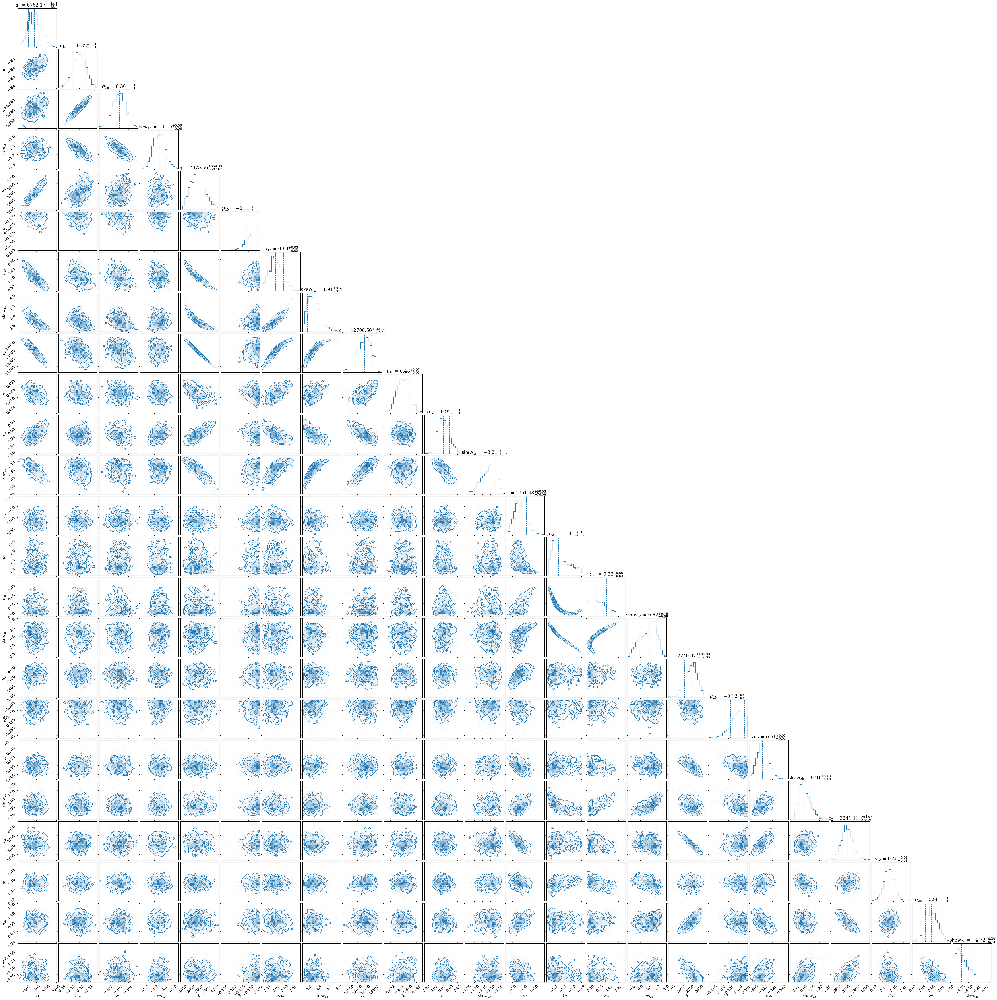

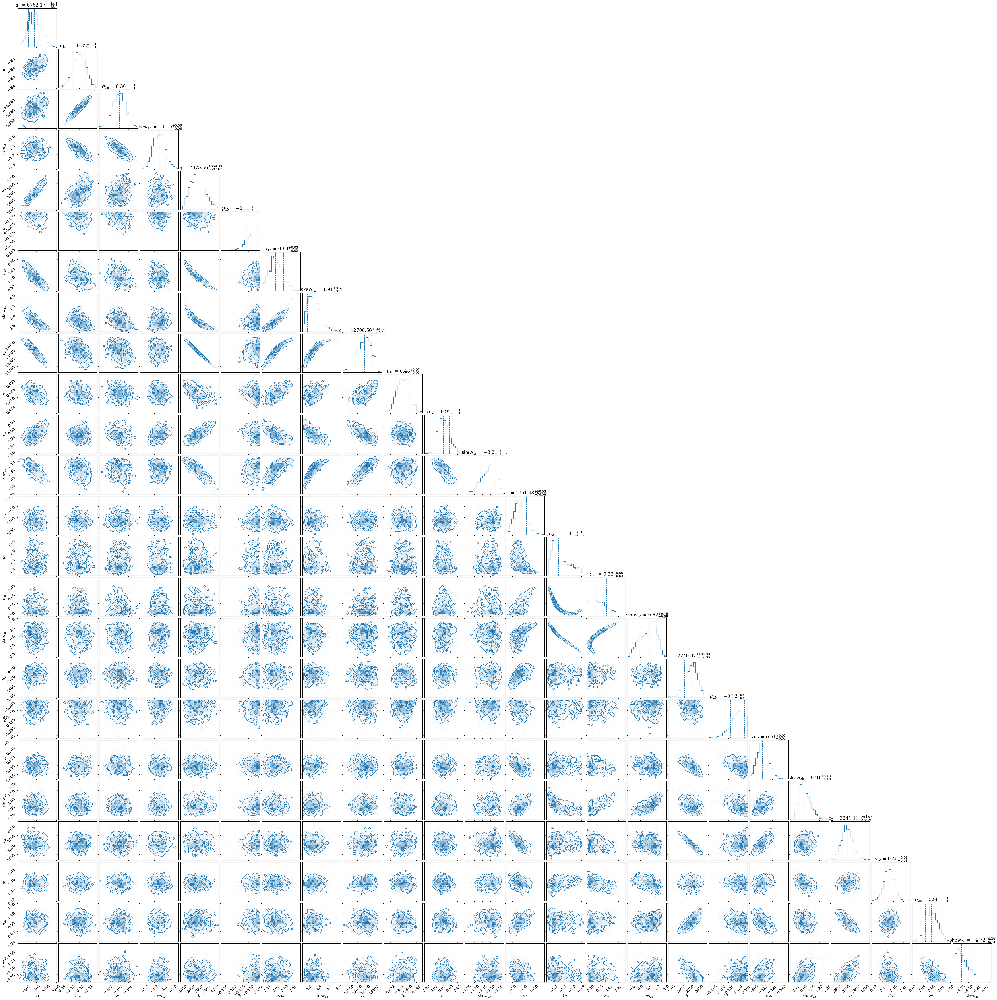

In [30]:
pc.plotting.corner(VF_results2, 
                   labels=labels2_tri, 
                   dims=range(len(labels2_tri)), 
                   show_titles=True, 
                   quantiles=[0.16, 0.5, 0.84])

In [31]:
lnzM2_VF = VF_results2['logz'][-1]
lnzM2_VF

-529.182974360868

In [32]:
VF_bestfit2 = np.mean(VF_results2['samples'], axis=0)

VF_bestfit2

array([ 6.7680923e+03, -8.2037985e-01,  3.6080977e-01, -1.1489315e+00,
        2.9271748e+03, -1.1289664e-01,  6.0022116e-01,  1.9882677e+00,
        1.2626400e+04,  4.8374429e-01,  9.2226464e-01, -3.3315263e+00,
        1.7579890e+03, -1.1235832e+00,  3.3898449e-01,  5.5155277e-01,
        2.7248213e+03, -1.1882109e-01,  5.0942421e-01,  9.2210829e-01,
        3.2662246e+03,  4.5106000e-01,  9.6034735e-01, -4.6688800e+00],
      dtype=float32)

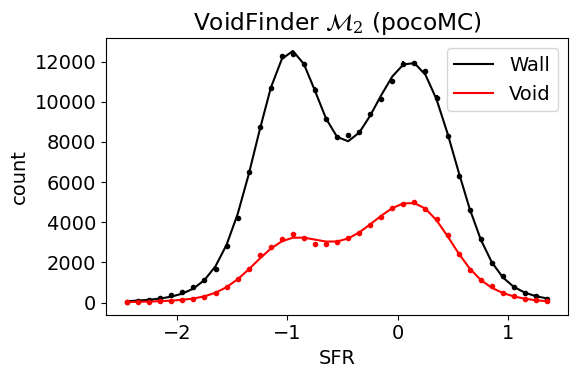

In [33]:
Model_2_plot(VF_bestfit2, 
             SFR[wall_vf], 
             SFR[void_vf], 
             SFR_bins, 
             3, 
             xlabel_text='SFR', 
             title_text=r'VoidFinder $\mathcal{M}_2$ (pocoMC)')

### Bayes Factor

In [34]:
lnB12_VF = lnzM1_VF - lnzM2_VF

B12_VF = np.exp(lnB12_VF)

print('VoidFinder SFR: B12 = {:.3g}; log(B12) = {:.3f}'.format(B12_VF, lnB12_VF*np.log10(np.exp(1))))

VoidFinder SFR: B12 = 0; log(B12) = -420.730


So both VoidFinder and V$^2$ favor $\mathcal{M}_2$, in which the two data sets come from different parent distributions, although VoidFinder favors it much more than V$^2$.